In [51]:
import gc, sys

from dotenv import dotenv_values
from plantilla import plantilla

env = dotenv_values("globals.env")

proyecto = 'Códigos'
subproyecto = 'Testing - Deep Learning con MapTilesDownloader'

globales = plantilla(proyecto=proyecto, 
                     subproyecto=subproyecto,
                     path_proyectos=env['PATH_PROYECTOS']
           )

path_proyecto   = globales[0]     # Ubicación de la carpeta del Proyecto
path_datain     = globales[1]
path_dataout    = globales[2]     # Bases procesadas por tus scripts
path_scripts    = globales[3]
path_figures    = globales[4]     # Output para las figuras/gráficos
path_maps       = globales[5]     # Output para los mapas (html o imagen)
path_tables     = globales[6]     # Output para las tablas (imagen o excel)
path_programas  = globales[7]


R:/Tesis Nico\Códigos\scripts\Testing - Deep Learning con MapTilesDownloader
El directorio en scripts existe. Creando carpetas.
R:/Tesis Nico\Códigos\data ya existe
R:/Tesis Nico\Códigos\data\data_in ya existe
R:/Tesis Nico\Códigos\data\data_out ya existe
R:/Tesis Nico\Códigos\data\data_out\Testing - Deep Learning con MapTilesDownloader ya existe
R:/Tesis Nico\Códigos\docs ya existe
R:/Tesis Nico\Códigos\scripts ya existe
R:/Tesis Nico\Códigos\scripts\Testing - Deep Learning con MapTilesDownloader ya existe
R:/Tesis Nico\Códigos\outputs ya existe
R:/Tesis Nico\Códigos\outputs\figures ya existe
R:/Tesis Nico\Códigos\outputs\figures\Testing - Deep Learning con MapTilesDownloader ya existe
R:/Tesis Nico\Códigos\outputs\maps ya existe
R:/Tesis Nico\Códigos\outputs\maps\Testing - Deep Learning con MapTilesDownloader ya existe
R:/Tesis Nico\Códigos\outputs\tables ya existe
R:/Tesis Nico\Códigos\outputs\tables\Testing - Deep Learning con MapTilesDownloader ya existe


In [52]:
from tensorflow.keras import layers, models, Model
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow import keras
import os
from PIL import Image

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# the next 3 lines of code are for my machine and setup due to https://github.com/tensorflow/tensorflow/issues/43174
import tensorflow as tf

# physical_devices = tf.config.list_physical_devices("GPU")
# tf.config.experimental.set_memory_growth(physical_devices[0], True)


In [53]:
df = pd.read_parquet(rf"{path_dataout}\dataset_amba.parquet")


In [46]:
predicted_datasets = [f for f in os.listdir(path_dataout) if f.startswith("preds_effnet_b0")]
df = pd.read_parquet(os.path.join(path_dataout, 'preds_mobnet_v3_rmax.parquet'))
df['link'] = df['filename'].apply(lambda 
                                  x: x.strip('.jpeg')[-9:])

In [47]:
df

,filename,real,pred,link
0,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.390771,0.242974,064413609
1,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.598688,0.659929,064901302
2,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.461136,-0.262433,065681006
3,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.791932,0.721598,020061307
4,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.232488,0.475939,064900707
...,...,...,...,...
2580,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.339379,0.347182,064901405
2581,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.719449,0.639171,064902103
2582,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.224121,0.416240,065601615
2583,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.300636,0.458558,064275512


In [48]:
df.real.max()

0.8723715

C:\Users\ofici\AppData\Local\Temp\ipykernel_11540\4017065201.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  g.ax_joint.plot(lims, lims, '-r', color='orange', linewidth=2)


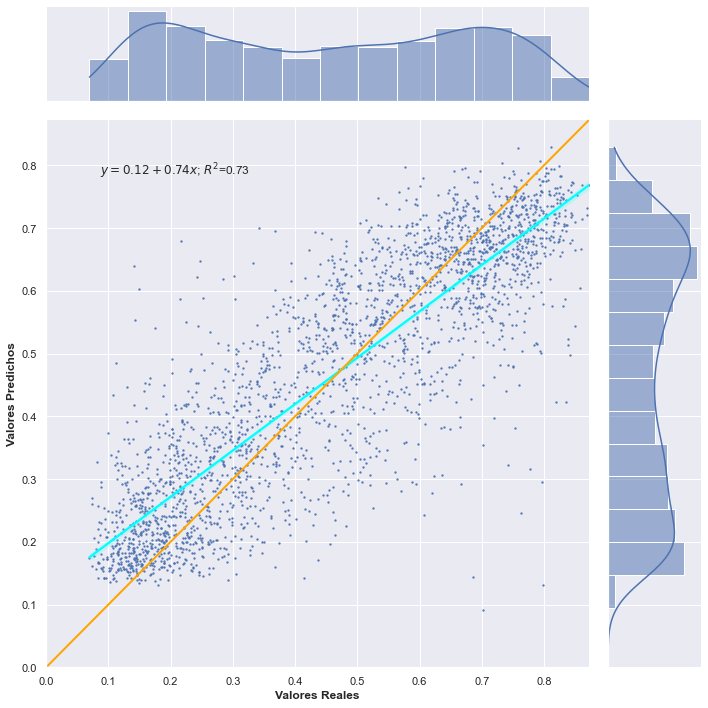

In [50]:
import scipy

# Resultado general
slope, intercept, r, p_value, std_err = scipy.stats.linregress(df['real'], df['pred'])

# Gráfico de correlacion
sns.set(rc={'figure.figsize':(11.7,8.27)})
g = sns.jointplot(data=df, x='real', y='pred', kind='reg', xlim=(0, df.real.max()), ylim=(0, df.real.max()),
                  height=10, joint_kws={'line_kws':{'color':'cyan'}}, scatter_kws={'s': 2}
                  )
g.ax_joint.set_xlabel('Valores Reales', fontweight='bold')
g.ax_joint.set_ylabel('Valores Predichos', fontweight='bold')

# Diagonal
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r', color='orange', linewidth=2)

# Texto con la regresión
plt.text(0.1, 0.9, f"$y={intercept:.2f}+{slope:.2f}x$; $R^2$={r**2:.2f}", transform=g.ax_joint.transAxes, fontsize=12)

g.savefig(f'{path_dataout}\preds_effnet_b0.png', dpi=300)

In [44]:
g.fig.show()

C:\Users\ofici\AppData\Local\Temp\ipykernel_11540\3161130865.py:1: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  g.fig.show()


In [18]:
f"y={intercept:.2f}+{slope:.2f}x; R2={r**2:.2f}"

'y=297.66+0.15x; R2=0.14'

In [10]:
slope, intercept, r_value**2, p_value, std_err

(0.14651924938763522,
 297.6637126233479,
 0.1442979508921428,
 1.6211261131901576e-89,
 0.007020429558115363)

In [47]:
physical_devices = tf.config.list_physical_devices("GPU")
tf.config.experimental.set_memory_growth(physical_devices[0], True)


C:\Users\ofici\AppData\Local\Temp\ipykernel_27384\313199269.py:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  g.ax_joint.plot(lims, lims, '-r', color='orange', linewidth=2)


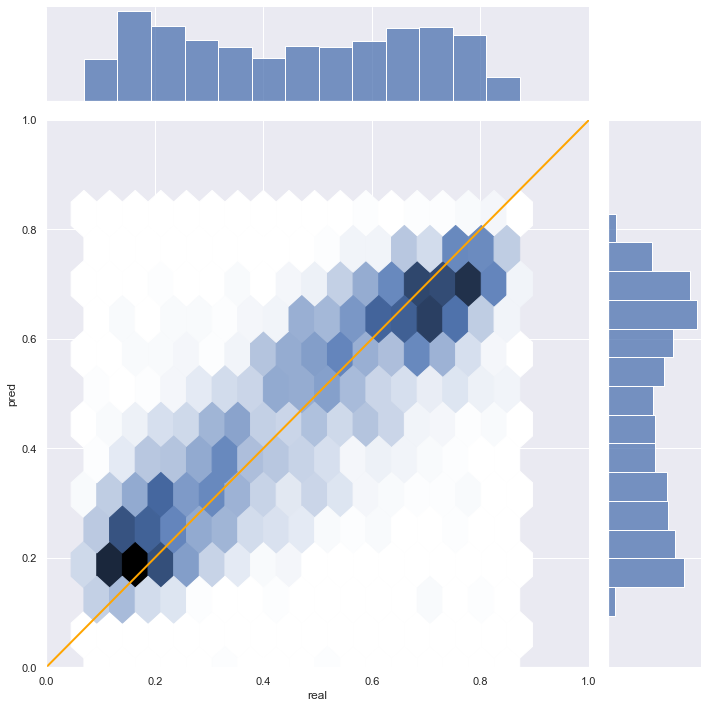

In [41]:
# Gráfico de correlacion
sns.set(rc={'figure.figsize':(11.7,8.27)})
g = sns.jointplot(data=df, x='real', y='pred', xlim=(0,1), ylim=(0,1), kind='hex', 
                  height=10)#, joint_kws={'line_kws':{'color':'cyan'}})

# Draw a line of x=y 
x0, x1 = g.ax_joint.get_xlim()
y0, y1 = g.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
g.ax_joint.plot(lims, lims, '-r', color='orange', linewidth=2)

In [90]:
import tensorflow_addons as tfa
opt = tf.keras.optimizers.SGD(learning_rate=0.00005, momentum=0.9, nesterov=True)  #  1=No friction

model = models.load_model(f"{path_dataout}\models\effnet_b0_rmax.h5", 
                          compile=True, custom_objects={'Addons>Lookahead': tfa.optimizers.Lookahead(opt, sync_period=6, slow_step_size=0.5)})

In [91]:
# def create_relu_advanced(max_value=1.):        
#     def relu_advanced(x):
#         return K.relu(x, max_value=K.cast_to_floatx(max_value))
#     return relu_advanced

dataset_amba = pd.read_parquet(r"R:\Tesis Nico\Códigos\data\data_out\Testing - Deep Learning con MapTilesDownloader\dataset_amba.parquet")
path_images = 'R:\Tesis Nico\Códigos\data\data_in\rmax'
model = models.load_model(r"R:\Tesis Nico\Códigos\data\data_out\Testing - Deep Learning con MapTilesDownloader\models\effnet_b0_rmax.h5", 
                          compile=False)#, custom_objects={'relu_advanced': create_relu_advanced()})


In [92]:
dataset_amba.head(5)

,link,provincia,eph_codagl,eph_aglome,codaglo,aglomerado,aglo_eph,AMBA_legal,rmin,rmax,...,viv_part,indvilla,icv2010,nbi_rc_val,icpag,rmax_d,icv2010_d,rmin_d,fuente,image
1,020010201,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.619610,0.280022,...,148,-0.421323,0.518004,0.267081,0.07,4,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
2,020010202,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.560548,0.220684,...,124,-0.421323,0.509632,0.203125,0.07,3,1,2,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
3,020010203,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.600326,0.253551,...,104,-0.421323,0.528870,0.240385,0.08,3,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
4,020010204,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.608166,0.247386,...,120,-0.421323,0.547619,0.141104,0.13,3,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
5,020010205,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.624579,0.283721,...,82,-0.421323,0.537424,0.168421,0.12,4,1,4,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...


In [93]:
data = dataset_amba.drop_duplicates(subset='link')
data = data[['rmax','link']]
data = data.merge(df, on='link', how='inner')

if data['rmax'].equals(data['real']):
    print("El dataframe tiene los valores reales correctos.")
    data = data.drop(columns=['real'])
else:
    print("El dataframe tiene los valores reales incorrectos.")

El dataframe tiene los valores reales correctos.


In [94]:
data

,rmax,link,filename,pred
0,0.242302,020010210,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.440514
1,0.212245,020010306,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.475511
2,0.133273,020010320,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.477401
3,0.783248,020010403,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.450373
4,0.783248,020010403,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.457554
...,...,...,...,...
2580,0.369800,068820911,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.438698
2581,0.326492,068820914,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.512001
2582,0.685303,068821001,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.447387
2583,0.219096,068821608,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.437823


In [95]:
dataset_amba

,link,provincia,eph_codagl,eph_aglome,codaglo,aglomerado,aglo_eph,AMBA_legal,rmin,rmax,...,viv_part,indvilla,icv2010,nbi_rc_val,icpag,rmax_d,icv2010_d,rmin_d,fuente,image
1,020010201,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.619610,0.280022,...,148,-0.421323,0.518004,0.267081,0.07,4,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
2,020010202,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.560548,0.220684,...,124,-0.421323,0.509632,0.203125,0.07,3,1,2,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
3,020010203,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.600326,0.253551,...,104,-0.421323,0.528870,0.240385,0.08,3,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
4,020010204,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.608166,0.247386,...,120,-0.421323,0.547619,0.141104,0.13,3,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
5,020010205,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.624579,0.283721,...,82,-0.421323,0.537424,0.168421,0.12,4,1,4,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30214,068821701,Buenos Aires,NaN,None,NaN,None,0,1,0.589098,0.283901,...,351,0.762206,0.622167,0.101983,0.26,4,3,3,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
30215,068821702,Buenos Aires,NaN,None,NaN,None,0,1,0.556051,0.236500,...,285,0.762206,0.614635,0.079470,0.24,3,3,2,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
30217,068821704,Buenos Aires,NaN,None,NaN,None,0,1,0.438193,0.145531,...,483,0.762206,0.571425,0.208247,0.09,1,2,1,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...
30218,068821705,Buenos Aires,NaN,None,NaN,None,0,1,0.384827,0.115289,...,495,0.762206,0.538318,0.279923,0.05,1,1,1,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...


In [96]:
test = data
def prepara_datos_para_prediccion(dataset, variable='rmax', images='filename', kind='reg'):


    def img_file_to_tensor(file, label):
        def _img_file_to_tensor(file, label):
            im = tf.image.decode_jpeg(tf.io.read_file(file), channels=3)
            im = tf.image.resize(im, [224, 224])
            im = tf.cast(im, tf.float32)
            label = tf.cast(label, tf.float32)
            return im, label

        return tf.py_function(_img_file_to_tensor, [file, label], [tf.float32, tf.float32])


    # Get list of filenames and corresponding list of labels
    filenames = tf.constant(dataset[images].to_list())
    if kind == "reg":
        labels = tf.constant(dataset[variable].to_list())
    elif kind == "cla":
        labels = tf.one_hot(
            (df[variable] - 1).to_list(), 10
        )  # Fist class corresponds to decile 1, etc.

    # Create a dataset from the filenames and labels
    tf_dataset = tf.data.Dataset.from_tensor_slices((filenames, labels))
    tf_dataset = tf_dataset.map(img_file_to_tensor)  # Parse every image in the dataset using `map`

    tf_dataset = tf_dataset.batch(5)
    return tf_dataset

test_dataset = prepara_datos_para_prediccion(data)
full_dataset = prepara_datos_para_prediccion(dataset_amba, images='image')

In [ ]:
predicted = model.predict(full_dataset)

In [98]:
dataset_amba['predicted'] = predicted.reshape(-1)

In [99]:
dataset_amba['abs_dif'] = abs(dataset_amba['rmax'] - dataset_amba['predicted'])

In [121]:
dataset_amba['abs_dif'].mean() #/ dataset_amba['rmax'].mean()

0.19197759

(0.0, 1.0)

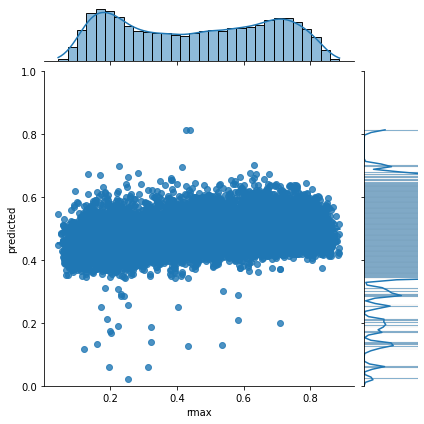

In [115]:
sns.jointplot(data=dataset_amba, y='predicted', x='rmax', kind='reg')
plt.ylim(0,1)
plt.xlim(0,1)

In [66]:
data['predicted'] = predicted.reshape(-1)

ValueError: Length of values (25848) does not match length of index (2585)

In [54]:
data.loc[data.predicted > 1, 'predicted'] = np.nan

In [55]:
data

,rmax,link,filename,pred,predicted
0,0.242302,020010210,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.440514,0.440514
1,0.212245,020010306,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.475511,0.475511
2,0.133273,020010320,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.477401,0.477401
3,0.783248,020010403,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.450373,0.450373
4,0.783248,020010403,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.457554,0.457554
...,...,...,...,...,...
2580,0.369800,068820911,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.438698,0.438698
2581,0.326492,068820914,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.512001,0.512001
2582,0.685303,068821001,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.447387,0.447387
2583,0.219096,068821608,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.437823,0.437823


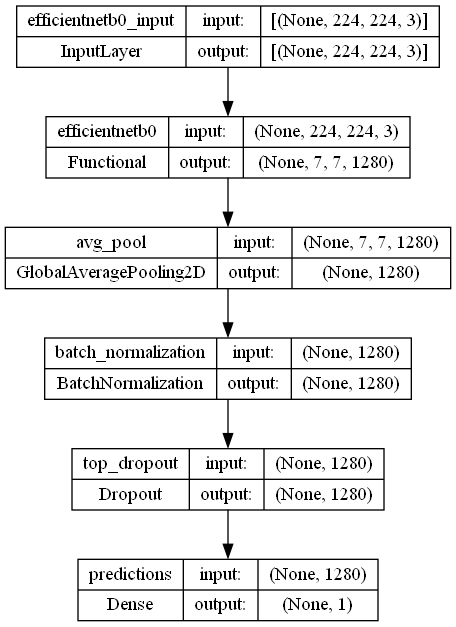

In [8]:
tf.keras.utils.plot_model(
    model,
    show_shapes=True)


In [10]:
data['link'] = data['link'].astype(str).str.zfill(9)

In [11]:
data[data.fuente == 'Google Maps'].fuente = 'GMaps'

C:\Users\ofici\AppData\Local\Temp\ipykernel_17400\640620803.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[data.fuente == 'Google Maps'].fuente = 'GMaps'


In [12]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# train, val = train_test_split(data, test_size=0.2, random_state=1)  # split the data with a validation size o 20%
test_generator = ImageDataGenerator(
)

test_generator = test_generator.flow_from_dataframe(
    dataframe=data, x_col="image", y_col="rmax", class_mode="raw", 
    target_size=(244, 244), batch_size=128, shuffle=False
)

Found 25848 validated image filenames.


In [13]:
data['image_name'] = data.image.apply(lambda x: x.split('\\')[-1])

In [14]:
def compare_predicted_vs_real(model, test_generator):

    df = get_values_from_generator(test_generator)
    # df['link'] = df['image_name'].str.replace('\D', '', regex=True).astype(int)
    df.loc[df.image_name.str.contains('ESRI'), 'fuente'] = 'ESRI'
    df.loc[df.image_name.str.contains('GMaps'), 'fuente'] = 'GMaps'

    print("Generating predictions for test dataset...")
    predicted_values = model.predict(test_generator)
    # predicted_values = np.argmax (predicted_values, axis = 1)
    
    # df['Predicted Value'] = predicted_values[:,0]

    return df, predicted_values

In [15]:
df, pred_val = compare_predicted_vs_real(model, test_generator)

Generating predictions for test dataset...
202/202 [==============================] - 272s 1s/step


In [82]:
test_generator

In [34]:
pred_val

array([[51.61936   ],
       [-0.53545856],
       [ 0.1776427 ],
       ...,
       [-0.1238099 ],
       [-0.08366476],
       [ 0.06240959]], dtype=float32)

In [35]:
pd.DataFrame(pred_val, columns=['predicted_value'])

,predicted_value
0,51.619362
1,-0.535459
2,0.177643
3,-1.081936
4,-0.135308
...,...
25843,-0.054579
25844,-0.450106
25845,-0.123810
25846,-0.083665


In [62]:
df = pd.concat([df['image'], pd.DataFrame(pred_val, columns=['predicted_value'])], axis=1)
df['link'] = df['image'].apply(lambda x: x.split('/')[-1]).str.replace('\D','', regex=True)
df['fuente'] = df['image'].apply(lambda x: x.split('/')[-1].split('_')[0])
df['fuente'] = df['fuente'].replace({'ESRI': 'ESRI', 'GMaps': 'Google Maps'})

In [67]:
data = data.merge(df.drop(columns='image'), on=['link','fuente'], how='left', validate='1:1', indicator=True)

In [73]:
data

,link,provincia,eph_codagl,eph_aglome,codaglo,aglomerado,aglo_eph,AMBA_legal,rmin,rmax,...,icv2010,nbi_rc_val,icpag,rmax_d,icv2010_d,rmin_d,fuente,image,predicted_value,_merge
0,020010201,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.619610,0.280022,...,0.518004,0.267081,0.07,4,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,51.619362,both
1,020010202,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.560548,0.220684,...,0.509632,0.203125,0.07,3,1,2,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-0.535459,both
2,020010203,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.600326,0.253551,...,0.528870,0.240385,0.08,3,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,0.177643,both
3,020010204,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.608166,0.247386,...,0.547619,0.141104,0.13,3,1,3,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-1.081936,both
4,020010205,Ciudad Autónoma de Buenos Aires,1.0,CABA,1.0,Gran Buenos Aires,1,1,0.624579,0.283721,...,0.537424,0.168421,0.12,4,1,4,ESRI,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-0.135308,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25843,068821701,Buenos Aires,NaN,None,NaN,None,0,1,0.589098,0.283901,...,0.622167,0.101983,0.26,4,3,3,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-0.054579,both
25844,068821702,Buenos Aires,NaN,None,NaN,None,0,1,0.556051,0.236500,...,0.614635,0.079470,0.24,3,3,2,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-0.450106,both
25845,068821704,Buenos Aires,NaN,None,NaN,None,0,1,0.438193,0.145531,...,0.571425,0.208247,0.09,1,2,1,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-0.123810,both
25846,068821705,Buenos Aires,NaN,None,NaN,None,0,1,0.384827,0.115289,...,0.538318,0.279923,0.05,1,1,1,Google Maps,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,-0.083665,both


In [81]:
((data['rmax'] - data['predicted_value'])**2).sum()

230150.4

<AxesSubplot:xlabel='rmax', ylabel='predicted_value'>

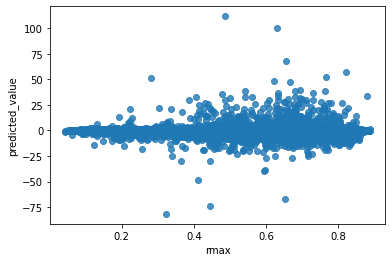

In [76]:
sns.regplot(data=data, x='rmax', y='predicted_value')

In [62]:
predicted_values = np.argmax(pred_val, axis = 1)

# ## ARREGLADO: Me ordeno mal los deciles: decile_1, decile_10, decile_2, decile_3, ... , decile_9
# keys = range(0,10)
# values = [1,10,2,3,4,5,6,7,8,9]
# repl_dict = dict(zip(keys, values))
# corrected_values = np.array([repl_dict[index] for index in predicted_values])


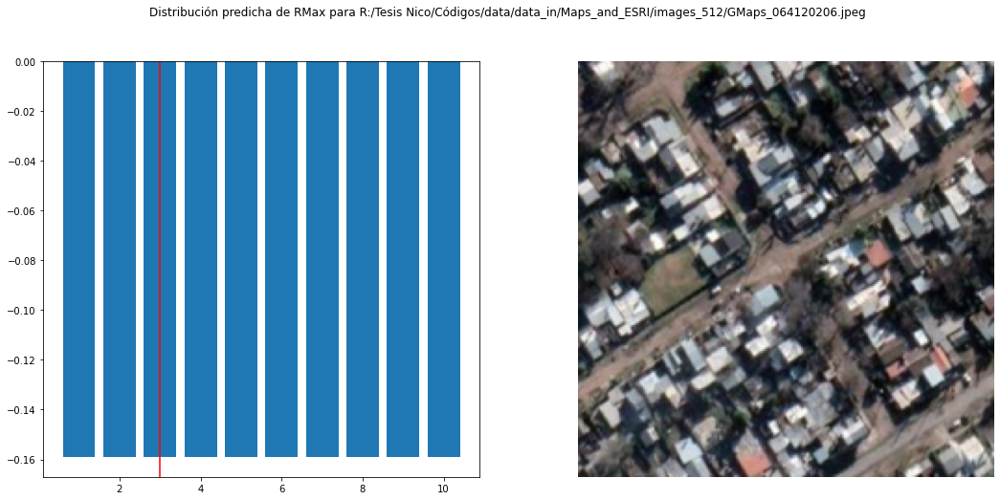

In [17]:
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

idx = np.random.randint(0, len(pred_val))

fig, axs = plt.subplots(1,2, figsize=(18,8))
axs[0].bar([1,2,3,4,5,6,7,8,9, 10], pred_val[idx]) #[1,10,2,3,4,5,6,7,8,9], pred_val[idx])
axs[0].axvline(df.loc[idx, 'rmax'], color='r')

img = mpimg.imread(df.loc[idx, 'image'])
axs[1].imshow(img)
axs[1].axis('off')

plt.suptitle(f"Distribución predicha de RMax para {df.loc[idx, 'image_name']}")
plt.show()

In [66]:
df['rmax'].value_counts()

10    2791
9     2770
8     2729
7     2624
6     2589
5     2547
2     2483
3     2481
4     2474
1     2360
Name: rmax, dtype: int64

In [68]:
predicted_values

array([9, 2, 0, ..., 0, 0, 0], dtype=int64)

In [18]:
def get_predicted_values(model, test_generator, kind='reg'):
    predicted_values = model.predict(test_generator)
    if kind=='cla':
        predicted_values = np.argmax(predicted_values, axis = 1)
    return predicted_values

def get_real_values(test_generator):
    real_values = np.concatenate([y for x, y in test_generator], axis=0)
    return real_values   

def plot_confusion_matrix(y_true, y_pred, model_name, normalize='pred'):
    from matplotlib import rcParams
    from sklearn.metrics import confusion_matrix
    
    # figure size in inches
    rcParams['figure.figsize'] = 11.7,8.27
    
    assert normalize == 'pred' or normalize == 'true', "normalize must be 'pred' or 'true'"
    if normalize == 'pred':
        rows, cols = y_true, y_pred
        rows_lab, cols_lab = 'Real Values', 'Predicted Values'
    elif normalize == 'true':
        rows, cols = y_pred, y_true
        rows_lab, cols_lab = 'Predicted Values', 'Real Values'
    # Get confusion matrix as array
    result = confusion_matrix(rows, cols, normalize='true')

    ticks = range(1,11)
    sns_plot = sns.heatmap(result, xticklabels=ticks, yticklabels=ticks, annot=True)
    sns_plot.set(xlabel=cols_lab, ylabel=rows_lab)
    sns_plot.set_title(f'Matriz de Confusión del Modelo {model_name}', fontsize=14)
    
    fig = sns_plot.get_figure()
    fig.text(0.1, 0.04, "Nota: Valores normalizados respecto a las filas", fontsize=10)

    # fig.savefig(f'{path_figures}/confusion_matrix_{model_name}_{normalize}.png')

plot_confusion_matrix(df['RMax (Real Value)'],df['Predicted Values'], 'resnet_B0', 'pred')

KeyError: 'RMax (Real Value)'

Text(0.1, 0.04, 'Nota: Valores normalizados respecto a las filas')

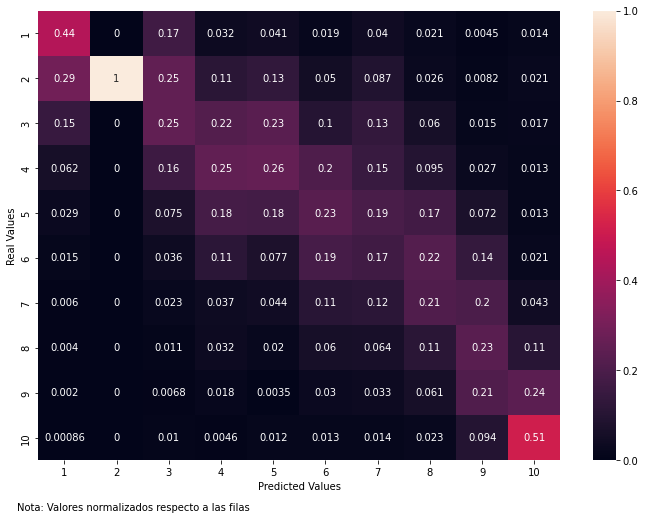

In [134]:
from matplotlib import rcParams

# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27

df['RMax (Real Value)'] = df['rmax']
df['Predicted Values'] = predicted_values + 1

from sklearn.metrics import confusion_matrix
result = confusion_matrix(df['RMax (Real Value)'], df['Predicted Values'] , normalize='pred')

ticks = range(1,11)
sns_plot = sns.heatmap(result, xticklabels=ticks, yticklabels=ticks, annot=True)#, kind='reg', scatter_kws={'s':1})
sns_plot.set(xlabel='Predicted Values', ylabel='Real Values')
plt.gcf().text(0.1, 0.04, "Nota: Valores normalizados respecto a las filas", fontsize=10)

# sns_plot.get_figure().savefig(f'{path_figures}/confusion_matrix_effnet_b0_rmax_d.png')

[Text(0.5, 53.42999999999999, 'Predicted Values'),
 Text(84.3, 0.5, 'Real Values')]

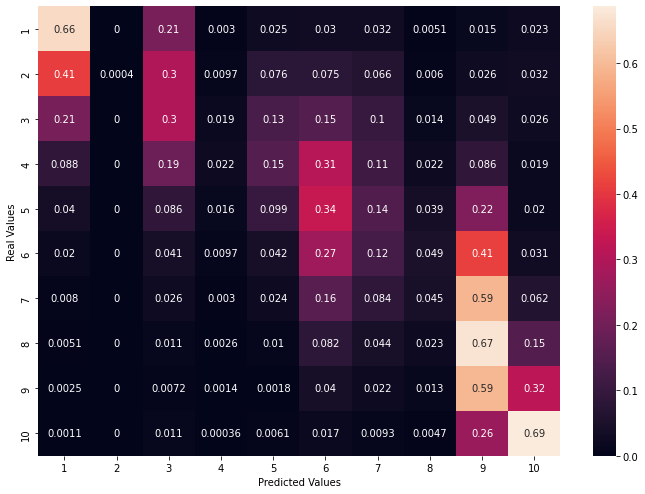

In [77]:
from sklearn.metrics import confusion_matrix
result = confusion_matrix(df['RMax (Real Value)'], df['Predicted Values'] , normalize='true')

ticks = range(1,11)
sns_plot = sns.heatmap(result, xticklabels=ticks, yticklabels=ticks, annot=True)#, kind='reg', scatter_kws={'s':1})
sns_plot.set(xlabel='Predicted Values', ylabel='Real Values')

In [208]:
data.merge(df, on='link', how='outer', indicator=True)

10    8325
4     5329
8     2865
6     2362
1     1809
9     1789
3     1017
7      996
5      861
2      495
Name: Predicted Values, dtype: int64

In [156]:
d = {
    'real': df['RMax (Real Value)'].to_numpy(),
    'pred': predicted_values
}
pd.DataFrame(data=d)

,real,pred
0,4,9
1,3,2
2,3,0
3,3,9
4,4,0
...,...,...
25843,4,2
25844,3,0
25845,1,0
25846,1,0


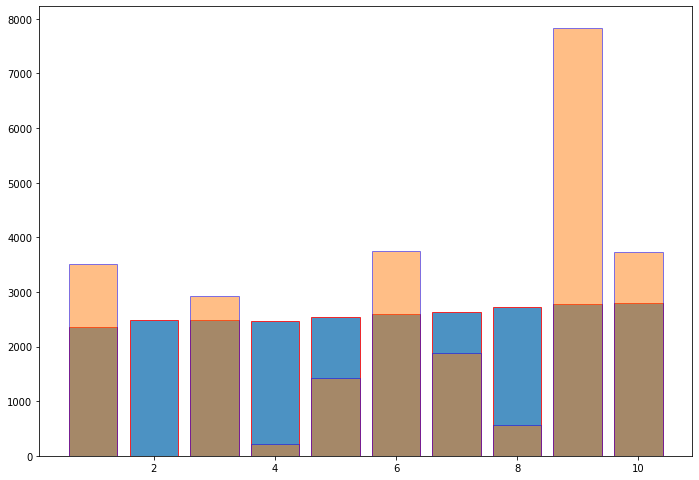

In [83]:
counts = df['RMax (Real Value)'].value_counts()
plt.bar(counts.index, counts.values, alpha=0.8, edgecolor='r')
counts = df['Predicted Values'].value_counts()
plt.bar(counts.index, counts.values, alpha=0.5, edgecolor='b')

plt.savefig(f'{path_figures}/histograma_rmax_d.png')

In [87]:
df

,image,rmax,image_name,fuente,RMax (Real Value),Predicted Values
0,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,4,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,ESRI,4,10
1,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,3,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,ESRI,3,3
2,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,3,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,ESRI,3,1
3,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,3,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,ESRI,3,10
4,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,4,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,ESRI,4,1
...,...,...,...,...,...,...
25843,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,4,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,GMaps,4,3
25844,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,3,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,GMaps,3,1
25845,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,1,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,GMaps,1,1
25846,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,1,R:/Tesis Nico/Códigos/data/data_in/Maps_and_ES...,GMaps,1,1


In [100]:
df['link'] = df.image.apply(lambda x: x.split('/')[-1][-14:-5]).astype(int)

In [39]:
import geopandas as gpd
plot = df.drop_duplicates(subset='link')

geo = gpd.read_file(r"R:\Shapefiles\ICPAG\Sin barrios pop y cerr\Full\base_icpag_full.shp")
geo.link = geo.link.astype(int)
geo = geo[['link','geometry']].merge(plot, on='link')

NameError: name 'df' is not defined

In [ ]:
geo.plot(column='Predicted Values')
# geo.explore(column='Predicted Values', cmap='Spectral_r', 
#             tiles="https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}", attr='ESRI')

In [102]:
geo.explore(column='Predicted Values', cmap='Spectral_r')

#### TIGRE: Romper RC

In [8]:
tigre = gpd.read_file(
    r"R:\Tesis Nico\Códigos\data\data_in\Rasters Tigre ejemplo rasterización.shp"
)

In [9]:
tigre['image'] = r"R:\Tesis Nico\Códigos\data\data_out\Testing - Deep Learning con MapTilesDownloader\inference\rasters_map_tigre\ESRI_" + tigre['id'].astype(str) + ".tiff"

In [30]:
def classify(img_path, model):
    from tensorflow.keras.preprocessing import image

    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)

    img_batch = np.expand_dims(img_array, axis=0)

    prediction = model.predict(img_batch)
    prediction = np.argmax(prediction, axis = 1)

    return prediction

for idx in range(0, len(tigre)):
    tigre.loc[idx, "pred"] = classify(tigre.at[idx, "image"], model)


1/1 [==============================] - 0s 34ms/step


In [31]:
# tigre.pred = tigre.pred.replace(repl_dict)

NameError: name 'repl_dict' is not defined

In [32]:
import cartopy.io.img_tiles as cimgt
import cartopy.crs as crs

map_provider = cimgt.GoogleTiles(
    url="https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
)

In [33]:
import matplotlib

cmap = matplotlib.cm.get_cmap('Spectral')
color = cmap(6/10)
matplotlib.colors.to_hex(color)


'#e6f598'

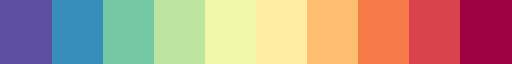

In [34]:
cmap = cmap.reversed()
cmaplist = [cmap(i) for i in range(cmap.N)]

matplotlib.colors.LinearSegmentedColormap.from_list('a', cmaplist, N=10)


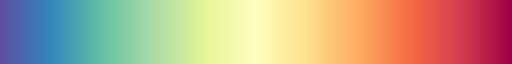

In [35]:
cmap

In [36]:
cmap(6/10)

(0.996078431372549, 0.8784313725490196, 0.5450980392156862, 1.0)

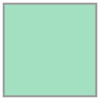

In [37]:
tigre.unary_union

In [43]:
import folium 
m = tigre.explore(column='pred', cmap='Spectral_r', 
            tiles="https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}", attr='ESRI')

m2 = geo[geo.link == 68050811].explore(m=m, style_kwds={'color': matplotlib.colors.to_hex(color)},)

m3 = gpd.GeoDataFrame(geometry=[tigre.geometry.unary_union], crs=tigre.crs).explore(m=m2, style_kwds={'color': matplotlib.colors.to_hex(color)
, 'fillOpacity': 0},)

folium.LayerControl().add_to(m)
m

In [53]:
m = geo[geo.link == 66480404].explore(style_kwds={'color': 'red', 'fillOpacity': 0, 'weight': 5},
            tiles="https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}", attr='ESRI')
m.save('map.html')

In [70]:
geo[geo.link == '066480404'].explore()

In [ ]:
66480404

In [366]:
gdf2 = gpd.GeoDataFrame(geometry=[tigre.geometry.unary_union], crs=tigre.crs)


In [66]:
pd.set_option('display.max_columns', 500)

In [57]:
geo = gpd.read_file(r"R:\Shapefiles\ICPAG\Sin barrios pop y cerr\Full\base_icpag_full.shp")

,link,AREA,PERIMETER,PAISXRAD10,PAISXRAD_1,PROV,DEPTO,FRAC,RADIO,TIPO,...,total,total_val,con_nbi,sin_nbi,nbi_rc,nbi_rc_val,icpagNabs,CicpagNv,icpag,geometry
21478,068050811,214798.188,2157.325,27613,27613,06,805,08,11,U,...,477,477.0,93,384,0.194969,0.194969,-0.64408,20.0,0.2,"POLYGON ((-58.59344 -34.43464, -58.59352 -34.4..."


In [67]:
geo[geo.link == '068050811']

,link,AREA,PERIMETER,PAISXRAD10,PAISXRAD_1,PROV,DEPTO,FRAC,RADIO,TIPO,link_dpto,departamen,provincia,eph_codagl,eph_aglome,codaglo,aglomerado,aglo_eph,AMBA_legal,rmin,rmax,rminp50,rminp25,rminp75,rmaxp50,rmaxp25,rmaxp75,p_usd,pm2,obs_pm2,pm2_2019,obs_pm2_19,p_usd_2019,personas,viv_part,lvp1bvp50,lvpra_1bvp,lvprf_1bvp,lvp1bv,lvpra_1bv,lvprf_1bv,superficie,den_p,rural1,rural2,urbano,mergelvp,objectid_1,cod_fra,provdep,oid_,objectid,link_1,cod_fra_1,provdep_1,indicetmi,rrbn,rrsc,pa_complem,varon,mujer,totalpobl,poblnoasis,poblmenpri,f_edmen1ri,indedmen1r,univcompl,f_edunv,indeduniv,pobhogpart,hacinam,f__hacinam,indhacinam,sinretrete,f__sinretr,indsinretr,poblsinobr,inundsi,inundno,inundtotal,basusi,basuno,basutotal,villasi,villano,villatotal,var¥n,mujer1,totalpob_1,f_pobinund,f_pobbasu,f_pobvilla,indinund,indbasu,indvilla,indpa,p1305,link2,f_sobsocia,indobsoc,icv2010,mergeicv,cprov,nprov,CicvNr,CicvNp,CicvNv,CrmaxNr,CrmaxNp,CrmaxNv,Crmaxp50Nr,Crmaxp50Np,Crmaxp50Nv,Crmaxp25Nr,Crmaxp25Np,Crmaxp25Nv,Crmaxp75Nr,Crmaxp75Np,Crmaxp75Nv,CicvPr,CicvPp,CicvPv,CrmaxPr,CrmaxPp,CrmaxPv,Crmaxp50Pr,Crmaxp50Pp,Crmaxp50Pv,Crmaxp25Pr,Crmaxp25Pp,Crmaxp25Pv,Crmaxp75Pr,Crmaxp75Pp,Crmaxp75Pv,tasa_activ,tasa_emple,tasa_desoc,total,total_val,con_nbi,sin_nbi,nbi_rc,nbi_rc_val,icpagNabs,CicpagNv,icpag,geometry
21478,068050811,214798.188,2157.325,27613,27613,06,805,08,11,U,06805,Tigre,Buenos Aires,1.0,Partidos del GBA,0001,Gran Buenos Aires,1,1,0.522264,0.231826,0.526375,0.737931,0.315639,0.155153,0.345835,0.038235,450859.707031,1868.627441,4.0,NaN,1.0,NaN,1770.0,414.0,10.748093,10.758945,10.729181,10.858426,10.856044,10.826282,214908.69,82.36056,0.0,0.0,1.0,3,4963.0,0680508,6805,4962.0,4963.0,068050811,0680508,6805,0.789825,6.75,8.25,7.38,872.0,898.0,1770.0,1025.0,180.0,17.560976,0.656654,45.0,4.390244,0.099388,1770.0,661.0,37.344633,0.604236,62.0,3.502825,0.922812,83.0,11040.0,4788.0,15828.0,3876.0,11952.0,15828.0,2455.0,13373.0,15828.0,7838.0,7998.0,15836.0,69.714574,24.475878,15.502652,-0.273558,0.545902,0.774605,0.348983,281.0,068050811,0.524122,0.993344,6.264225,3,68.0,1.0,24.0,27.0,20.0,39.0,40.0,31.0,36.0,36.0,28.0,38.0,38.0,30.0,31.0,32.0,25.0,24.0,35.0,26.0,29.0,35.0,26.0,26.0,31.0,23.0,28.0,34.0,25.0,20.0,25.0,18.0,71.84,68.39,4.8,477,477.0,93,384,0.194969,0.194969,-0.64408,20.0,0.2,"POLYGON ((-58.59344 -34.43464, -58.59352 -34.4..."


In [312]:
order_start = [1,6,12,16,21]
order = []

for i in range(0,5):
    order_temp = [x+i for x in order_start]
    order += order_temp


In [327]:
tigre

,id,left,top,right,bottom,geometry,image,pred
0,1.0,-58.601375,-34.42929,-58.599175,-34.43149,"POLYGON ((-6523475.267 -4086591.910, -6523230....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,7.0
1,2.0,-58.601375,-34.43149,-58.599175,-34.43369,"POLYGON ((-6523475.267 -4086888.829, -6523230....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,6.0
2,3.0,-58.601375,-34.43369,-58.599175,-34.43589,"POLYGON ((-6523475.267 -4087185.756, -6523230....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,6.0
3,4.0,-58.601375,-34.43589,-58.599175,-34.43809,"POLYGON ((-6523475.267 -4087482.691, -6523230....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,6.0
4,5.0,-58.601375,-34.43809,-58.599175,-34.44029,"POLYGON ((-6523475.267 -4087779.633, -6523230....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,4.0
5,6.0,-58.599175,-34.42929,-58.596975,-34.43149,"POLYGON ((-6523230.364 -4086591.910, -6522985....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,1.0
6,7.0,-58.599175,-34.43149,-58.596975,-34.43369,"POLYGON ((-6523230.364 -4086888.829, -6522985....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,3.0
7,8.0,-58.599175,-34.43369,-58.596975,-34.43589,"POLYGON ((-6523230.364 -4087185.756, -6522985....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,3.0
8,9.0,-58.599175,-34.43589,-58.596975,-34.43809,"POLYGON ((-6523230.364 -4087482.691, -6522985....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,3.0
9,10.0,-58.599175,-34.43809,-58.596975,-34.44029,"POLYGON ((-6523230.364 -4087779.633, -6522985....",R:\Tesis Nico\Códigos\data\data_out\Testing - ...,4.0


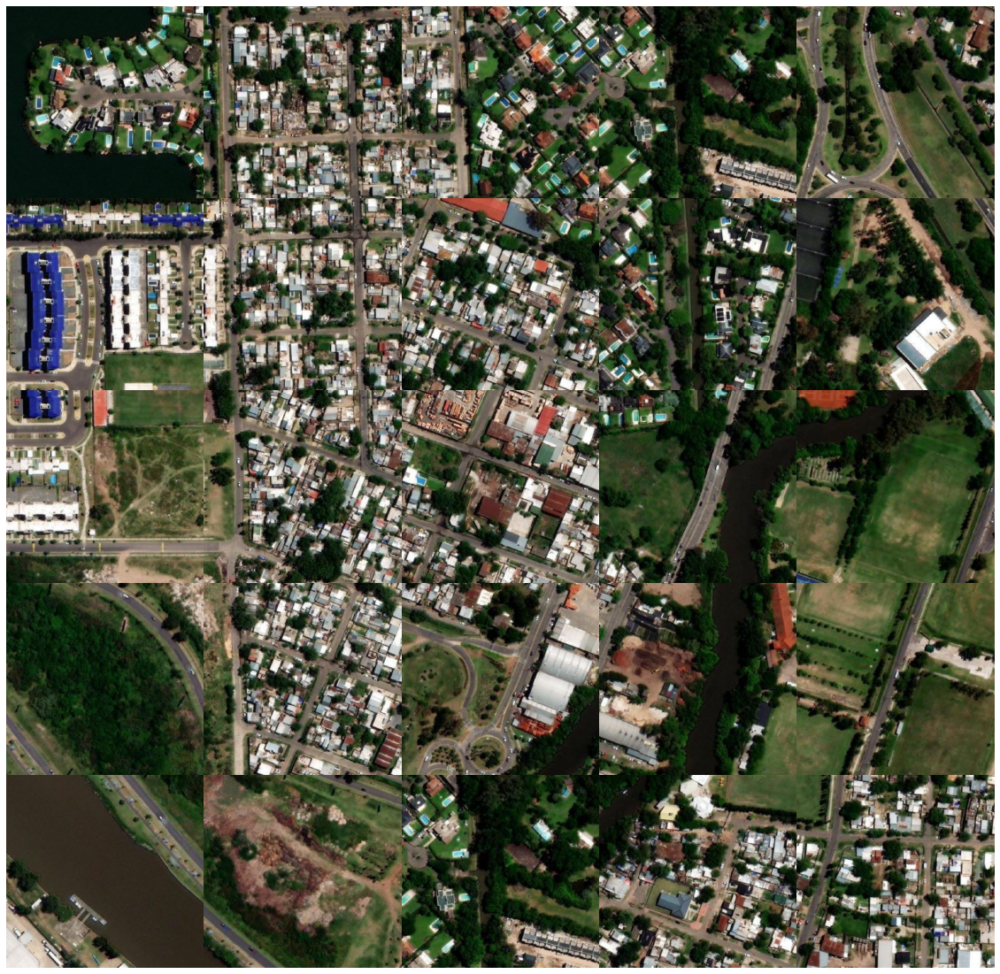

In [326]:
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(20,20))
row = 0
col = 0
for idx in order:
    if col==5:
        col=0
        row+=1
        
    axes[row, col].axis("off")
    img = mpimg.imread(tigre.loc[tigre.id == idx, 'image'].values[0])
    axes[row, col].imshow(img, cmap="gray", aspect="auto")

    col += 1

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()


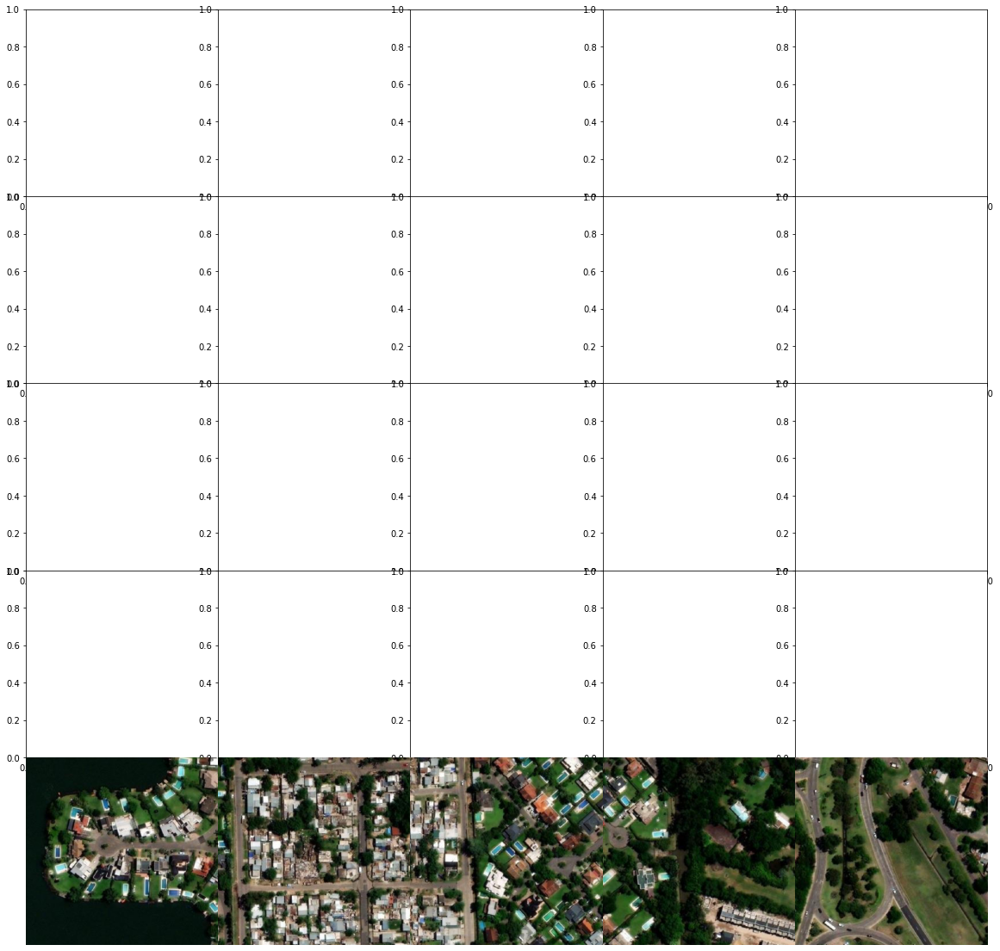

In [333]:
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(20,20))
col=0
for idx in order[:5]:
    if col==5:
        col=0
        # row+=1
        
    axes[row, col].axis("off")
    img = mpimg.imread(tigre.loc[tigre.id == idx, 'image'].values[0])
    axes[row, col].imshow(img, cmap="gray", aspect="auto")

    col += 1
plt.subplots_adjust(wspace=0, hspace=0)

plt.show()


In [322]:
tigre.loc[tigre.id == idx, 'image'].values[0]

'R:\\Tesis Nico\\Códigos\\data\\data_out\\Testing - Deep Learning con MapTilesDownloader\\inference\\rasters_map_tigre\\ESRI_1.0.tiff'

## HASTA ACA JOYA

In [ ]:
%tensorboard


In [ ]:
# for i in range(0, len(data), 100):
#     df = open_images_and_predict(model, data, path_images, i)

In [ ]:
# Las prediciones están concentradas en 1...
import seaborn as sns
sns.histplot(data.rmax)

In [ ]:
val

In [ ]:
sns.scatterplot(data=val, x='rmax_c', y='predict', hue='fuente')

In [ ]:
# El modelo original sobreestima el rmax
sns.histplot(val.predict - val.rmax_c)
print(abs(val.predict - val.rmax_c).mean())

In [ ]:
data.columns

In [ ]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

img = Image.open(r"R:\Tesis Nico\Códigos\data\data_in\Imagenes descargadas\ESRI_020010203.tiff")
img = np.array(img)
img = img[:, :, :3]           
img = np.expand_dims(img, axis=0) / 255
activations = activation_model.predict(img)

activations[-1]

In [ ]:
layer_outputs

In [ ]:
activations[1][0, :, :, 1].shape

In [ ]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

original_img = Image.open(r"R:\Tesis Nico\Códigos\data\data_in\Imagenes descargadas\ESRI_020010203.tiff")
img = np.array(original_img)
img = img[:, :, :3]           
img = np.expand_dims(img, axis=0) / 255
activations = activation_model.predict(img)

crop_img = crop_center(original_img, 300, 300)
display_activation(crop_img, activations, 4, 8, 2)

In [ ]:
crop_center(original_img, 300, 300)

In [ ]:
import keras.backend as K

# With a Keras function
get_all_layer_outputs = K.function([model.layers[0].input],
                                  [l.output for l in model.layers[1:]])

layer_output = get_all_layer_outputs([img]) # return the same thing

In [ ]:
model.layers

In [ ]:
layer_output[0].shape

In [ ]:
data.image_name.notna().sum()

In [ ]:
predictions.shape

In [ ]:
%tensorboard

In [78]:
pathfiles = r"R:\Tesis Nico\Códigos\data\data_in\Maps_and_ESRI\images_512"
filelist = os.listdir(pathfiles)
filelist = [os.path.join(pathfiles, f) for f in filelist if f.endswith('.jpeg')]

In [79]:
import zipfile

with zipfile.ZipFile(r'R:\Tesis Nico\Códigos\data\data_in\Maps_and_ESRI\imagenes_prueba.zip', 'w') as zipMe:        
    for file in filelist:
        zipMe.write(file, compress_type=zipfile.ZIP_DEFLATED)

In [ ]:
df = pd.read_parquet("R:\Tesis Nico\Códigos\data\data_in\Maps_and_ESRI\dataset_amba.parquet")
df.to_csv("R:\Tesis Nico\Códigos\data\data_in\Maps_and_ESRI\dataset_amba.csv", index=False)

In [ ]:
import zipfile

# Open a zip file at the given filepath. If it doesn't exist, create one.
# If the directory does not exist, it fails with FileNotFoundError
filepath = '/home/user/a/b/c/test.zip'
with zipfile.ZipFile(filepath, 'a') as zipf:
    # Add a file located at the source_path to the destination within the zip
    # file. It will overwrite existing files if the names collide, but it
    # will give a warning
    source_path = '/home/user/a/b/c/1.txt'
    destination = 'foobar.txt'
    zipf.write(source_path, destination)